# Example of the sign.mt pipeline

## Install requirements

In [ ]:
pip install numpy tdqm opencv-python vidgear pose-format git+https://github.com/sign-language-processing/segmentation pillow

  Cloning https://github.com/sign-language-processing/segmentation to /tmp/pip-req-build-tfa1_ftx
  Running command git clone --filter=blob:none --quiet https://github.com/sign-language-processing/segmentation /tmp/pip-req-build-tfa1_ftx
  Resolved https://github.com/sign-language-processing/segmentation to commit 4ac7b10b9878b6c60bbc14ba8ebe09af386f0cfe
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached python_dotenv-1.2.1-py3-none-any.whl.metadata (25 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 30.0 MB/s  0:00:001.0 MB/s eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29.5/29.5 MB 59.4 MB/s  0:00:001.7 MB/s eta 0:00:01:01
Using cached python_dotenv-1.2.1-py3-none-any.whl (21 kB)
  Attempting uninstall: pillow
    Found existing installation: pillow 12.0.0
    Uninstalling pillow-12.0.0:
      Successfully uninstalled pillow-12.0.0
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

## Step 1: Create a .pose file from a sign language video

Use the .pose toolkit to create a .pose file.

Run in terminal: video_to_pose --format mediapipe -i example.mp4 -o example.pose

Visualization

In [4]:
from pose_format import Pose
from pose_format.pose_visualizer import PoseVisualizer


with open("example.pose", "rb") as f:
    pose = Pose.read(f.read())

v = PoseVisualizer(pose)

v.save_video("example.mp4", v.draw())

0it [00:00, ?it/s]16:40:02 ::   WriteGear   :: WARNING  :: Optional `-disable_ffmpeg_window` flag is only available on Windows OS with `logging=False`. Discarding!
1701it [03:58,  7.13it/s]


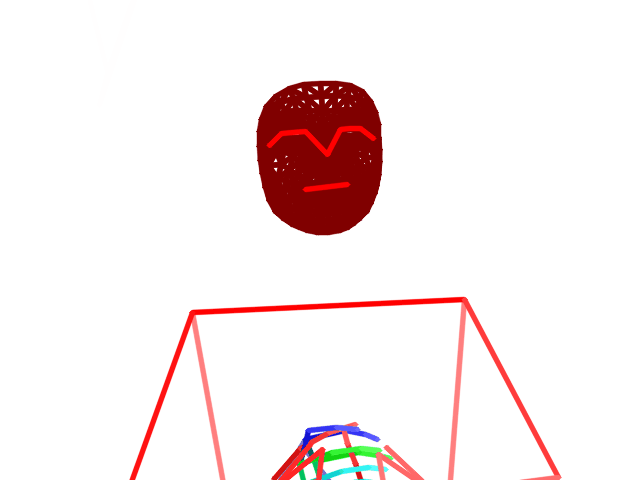

In [ ]:

from IPython.display import Image

v.save_gif("test.gif", v.draw())

display(Image(open('test.gif','rb').read()))

## Step 2: Segment the .pose file

Run in terminal : pose_to_segments --pose="example.pose" --elan="example.eaf" [--video="example.mp4"]

Parse the ELAN file

In [12]:
import xml.etree.ElementTree as ET

def parse_eaf_file(eaf_path):
    """Parse EAF file and extract time slots and annotations."""
    tree = ET.parse(eaf_path)
    root = tree.getroot()
    
    # Parse time slots
    time_slots = {}
    for time_slot in root.findall('.//TIME_SLOT'):
        slot_id = time_slot.get('TIME_SLOT_ID')
        time_value = int(time_slot.get('TIME_VALUE'))
        time_slots[slot_id] = time_value
    
    # Parse tiers
    tiers = {}
    for tier in root.findall('.//TIER'):
        tier_id = tier.get('TIER_ID')
        annotations = []
        
        for annotation in tier.findall('.//ALIGNABLE_ANNOTATION'):
            start_ref = annotation.get('TIME_SLOT_REF1')
            end_ref = annotation.get('TIME_SLOT_REF2')
            value = annotation.find('ANNOTATION_VALUE').text or ''
            
            if start_ref in time_slots and end_ref in time_slots:
                annotations.append({
                    'start': time_slots[start_ref],
                    'end': time_slots[end_ref],
                    'value': value
                })
        
        tiers[tier_id] = annotations
    
    return tiers

Extract the first segmentations.

In [14]:
tiers = parse_eaf_file("example.eaf")
first_sign = tiers['SIGN'][0] 
first_sentence = tiers['SENTENCE'][0]
first_sign, first_sentence

({'start': 1568, 'end': 1835, 'value': ''},
 {'start': 1568, 'end': 7407, 'value': ''})

Visualize:

In [18]:
import cv2
from PIL import Image as PILImage
def extract_sign_segment(video_path, start_ms, end_ms, output_gif='sign.gif', fps=10):
    # Open video
    cap = cv2.VideoCapture(video_path)
    video_fps = cap.get(cv2.CAP_PROP_FPS)
    
    # Calculate frame numbers
    start_frame = int((start_ms / 1000.0) * video_fps)
    end_frame = int((end_ms / 1000.0) * video_fps)
    
    # Extract frames
    frames = []
    cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame)
    
    frame_step = max(1, int(video_fps / fps))
    
    for frame_num in range(start_frame, end_frame + 1):
        ret, frame = cap.read()
        if not ret:
            break
        
        if (frame_num - start_frame) % frame_step == 0:
            # Convert BGR to RGB
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            frames.append(PILImage.fromarray(frame_rgb))
    
    cap.release()
    
    # Save as GIF
    if frames:
        duration = int(1000 / fps)
        frames[0].save(output_gif, save_all=True, append_images=frames[1:], 
                      duration=duration, loop=0)
    
    return output_gif

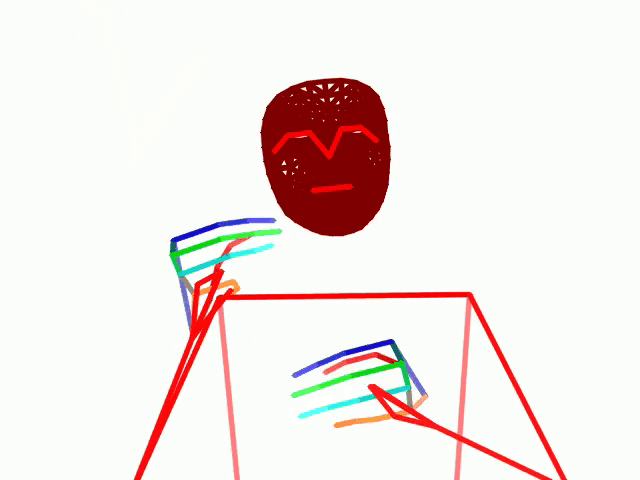

In [19]:
from IPython.display import Image
extract_sign_segment("exampleviz.mp4", 1568, 1835, "first_sign.gif")
display(Image(open('first_sign.gif','rb').read()))